In [6]:
# Beat tracking example
import librosa

# 1. Get the file path to an included audio example
filename = librosa.example('nutcracker')

# 2. Load the audio as a time series, waveform 'y', represented as a one-dimensional NumPy floating point array.
#   Store the sampling rate as 'sr' of y, that is, the number of samples per second of audio.
#   By default, all audio is mixed to mono and resampled to 22050 Hz at load time. This behavior can be overriden
#   by supplying additional arguments to librosa.load, e.g., librosa.load(filename, sr=44100 or sr=none)
y, sr = librosa.load(filename)

# 3. Run the default beat tracker
#   Output is an estimate of the tempo (in beats per minute)
#   and an array of frame numbers corresponding to detected beat events
#   Frames correspond to short windows of the signal y, each separated by hop_length = 512
#   samples. Librosa uses centered frames, so that the kth frame is centered around sample
#   k * hop_length
tempo, beat_frames = librosa.beat.beat_track(y=y, sr=sr)

print('Estimated tempo: {:.2f} beats per minute'.format(tempo))

# 4. Convert the frame indices of beat events into timestamps
#   beat_times will be an array of timestamps (in seconds) corresponding to detected beat events
beat_times = librosa.frames_to_time(beat_frames, sr=sr)

Estimated tempo: 107.67 beats per minute


In [20]:
# Feature extraction sample
import numpy as np
import librosa

# Load the example clip
y, sr = librosa.load(librosa.ex('nutcracker'))

# Set the hop length; at 22050 Hz, 512 samples ~= 23ms
hop_length = 512

# Using effects module, separate harmonics(tonal) and percussives(transient) into two waveforms.
# y is separated into these two time series and each have the same shape and duration as y.
# Motivation(s):
#   1. Percussive elements tend to be stronger indicators of rhythmic content, can help provide
#       stable beat tracking results
#   2. Percussive elements can pollute tonal feature representations (such as chroma) by contributing
#       energy across all frequency bands, so we'd be better of without them.
y_harmonic, y_percussive = librosa.effects.hpss(y)

# Beat track on the percussive signal
tempo, beat_frames = librosa.beat.beat_track(y=y_percussive, sr=sr)

# From feature module, extract the Mel-frequency cepstral coefficients from the raw signal y
# Output of this function is the matrix mfcc, which is a numpy.ndarray of shape (n_mfcc, T)
# where T denotes the track duration in frames. Note that we use the same hop_length here as
# in the beat tracker, so the detected beat_frames values correspond to columns of mfcc
mfcc = librosa.feature.mfcc(y=y, sr=sr, hop_length=hop_length, n_mfcc=13)

# Use feature manipulation, delta, which computes (smoothed) first-order differences among columns
# of its input. Result matrix mfcc_delta has the same shape as the input mfcc.
mfcc_delta = librosa.feature.delta(mfcc)

# Feature manipulation, sync, which aggregates columns of its input between sample indices (e.g. beat frames)
# Here, we've vertically stacked the mfcc and mfcc_delta matrices together. The results of this operation is
# a matrix beat_mfcc_delta with the same number of rows as its input, but the number of columns depends on beat_frames.
# Each column beat_mfcc_delta[:, k] will be the average of input columns between beat_frames[k] and beat_frames[k+1].
# beat_frames will be expanded to span the full range [0, T] so that all data is accounted for.
beat_mfcc_delta = librosa.util.sync(np.vstack([mfcc, mfcc_delta]), beat_frames)

# Compute chroma features from the harmonic signal
# Chromagram will be a numpy.ndarray of shape (12, T), and each row corresponds to a pitch class (e.g., C, C#, etc)
# Each column of chromagram is normalized by its peak value, though this behavior can be overridden by setting the
# norm parameter
chromagram = librosa.feature.chroma_cqt(y=y_harmonic, sr=sr)

# Syncronize chroma between beat events
# We've replaced the default aggregate operation(average, as used above for MFCCs), with the median
# In general, any statistical summarization function can be supplied here, including np.max(), np.min(), np.std()
beat_chroma = librosa.util.sync(chromagram, beat_frames, aggregate=np.median)

# Finally, stack all beat-synchronous features together
# Resulting in a feature matrix, beat_features, of shape (12+13+13, #beat intervals)
beat_features = np.vstack([beat_chroma, beat_mfcc_delta])



beat_mfcc_delta:  [[-5.96049988e+02 -4.71975800e+02 -4.18740723e+02 ... -2.30209213e+02
  -1.81633041e+02 -4.22515228e+02]
 [ 5.29752111e+00  1.19491829e+02  1.19481026e+02 ...  6.63411026e+01
   6.66919479e+01  7.45729675e+01]
 [ 1.79374278e+00  5.01075478e+01  1.31605749e+01 ... -6.48235626e+01
  -6.93393021e+01 -2.06293182e+01]
 ...
 [-6.54889792e-02 -1.46449924e-01  5.33926859e-02 ... -1.69989929e-01
   6.22177720e-01  1.29084542e-01]
 [-2.32196786e-02 -1.37379631e-01 -1.14387721e-02 ... -2.49835059e-01
   2.49134541e-01  8.30471702e-03]
 [ 2.86480542e-02 -2.01024517e-01 -5.54223433e-02 ...  7.50200152e-02
  -6.15619838e-01  7.62829632e-02]]


In [1]:
import sys
print(sys.version)


3.8.2 (default, Nov  4 2020, 21:23:28) 
[Clang 12.0.0 (clang-1200.0.32.28)]


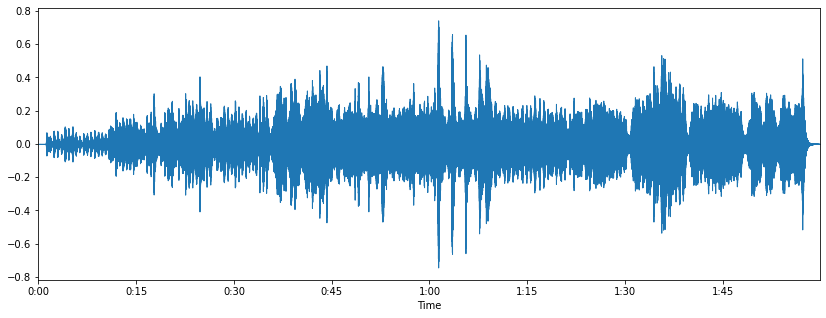

In [41]:
# Waveform - Plotting the audio array to show the amplitude envelope of a waveform.
%matplotlib inline
import matplotlib.pyplot as plt
import librosa
import librosa.display

plt.figure(figsize=(14, 5))

# Load the example clip
y, sr = librosa.load(librosa.ex('nutcracker'))

librosa.display.waveplot(y, sr=sr)

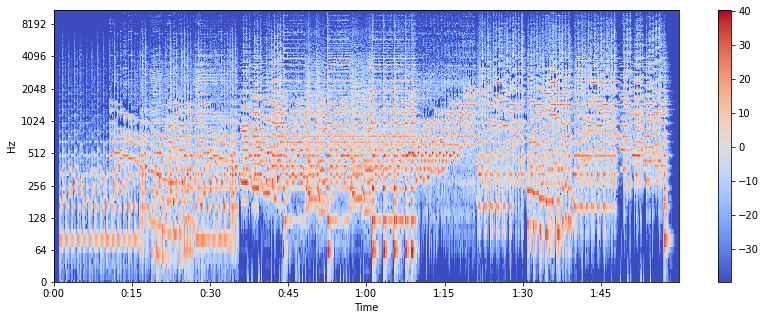

In [45]:
# Spectogram - visual representation of the spectrum of frequences of sound;
# sometimes called sonographs, voiceprints, or voicegrams. When the data is
# represented in a 3D plot, they may be called waterfalls. In 2D arrays, the 
# first axis is frequency, while the second axis is time.
%matplotlib inline
import matplotlib.pyplot as plt
import librosa
import librosa.display

# Load the example clip
y, sr = librosa.load(librosa.ex('nutcracker'))

X = librosa.stft(y)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))

# Vertical axis shows frequencies (from 0 to 10kHz)
# Horizontal axis shows the time of the clip
# Since we see that all action is taking place at the bottom of the
# spectrum, we can convert the frequency axis to a logarithmic one.
# librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')

librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar()

In [53]:
# DOES NOT WORK BECAUSE OF VSCODE
# Creating an audio signal at 220Hz. 
# An audio signal is a numpy array.
# We shall create one and pass it into the audio function
import numpy as np
import librosa
from IPython.display import Audio
from IPython.core.display import display

sr = 22050  # sample rate
T = 5.0     # seconds
t = np.linspace(0, T, int(T*sr), endpoint=False)    # time variable
x = 0.5 * np.sin(2 * np.pi * 220 * t)              # pure sine wave at 220 Hz

# Playing the audio
def play():
    display(Audio(librosa.ex('nutcracker'), autoplay=True))
play();
#Audio(x, rate=sr) # load a Numpy array

55


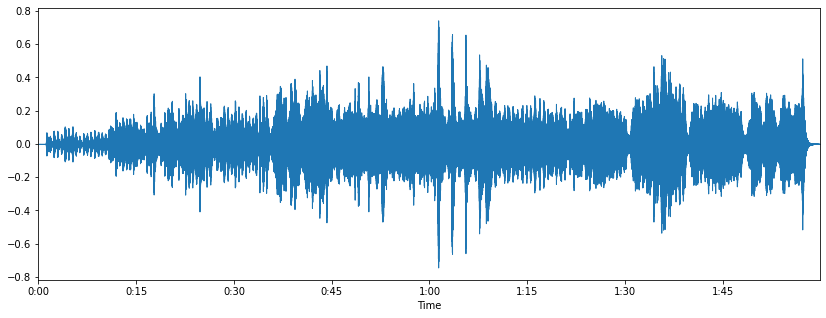

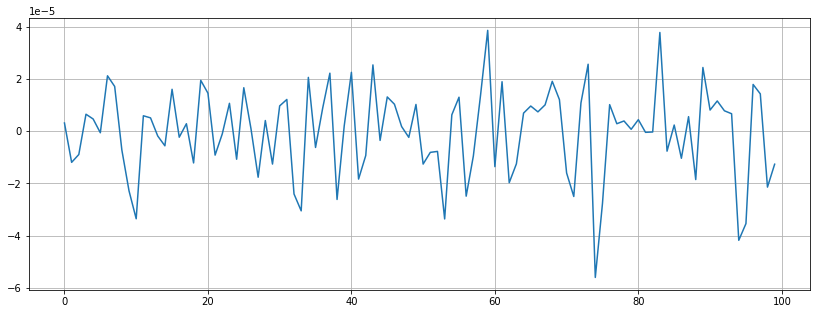

In [62]:
# Feature extraction - process of extracting features to use them for analysis
# Feature: Zero Crossing Rate - Rate of sign-changes along a signal, i.e.,
#           the rate at which the signal changes from positive to negative or back.
#           Heavily used in both speech recognition and music information retrieval.
#           It usually has higher values for highly percussive sounds like those in
#           metal and rock.

# Feature extraction sample
%matplotlib inline
import matplotlib.pyplot as plt
import librosa
import librosa.display

# Load the example clip
x, sr = librosa.load(librosa.ex('nutcracker'))

# Plot the signal
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, sr=sr)

# Zooming in
n0 = 9000
n1 = 9100
plt.figure(figsize=(14, 5))
plt.plot(x[n0:n1])
plt.grid()

# How many zero crossings are there?
zero_crossings = librosa.zero_crossings(x[n0:n1], pad=False)
print(sum(zero_crossings))

(5163,)


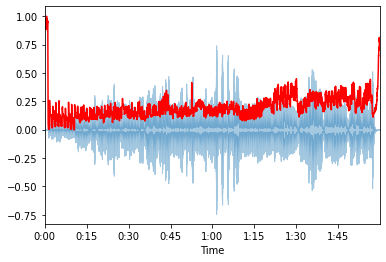

In [72]:
# Feature: Spectral Centroid - Indicates where the "centre of mass" for a sound is located and is calculated
#           as the weighted mean of the frequencies present in the sound. Consider two songs, one from a
#           blues genre and the other belonging to metal. Now, as compared to the blues genre song, which is
#           the same throughout its length, the metal song has more frequencies towards its end. So the
#           spectral centroid for blues song will lie somewhere near the middle of its spectrum while that
#           for a metal song would be towards its end.

# Feature extraction sample
%matplotlib inline
import matplotlib.pyplot as plt
import librosa
import librosa.display
import sklearn

# Load the example clip
x, sr = librosa.load(librosa.ex('nutcracker'))

spectral_centroids = librosa.feature.spectral_centroid(x, sr=sr)[0]
print(spectral_centroids.shape)

# Computing the time variable for visualization
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)

# Normalising the spectral centroid for visualisation
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)

# Plotting the Spectral Centroid along the waveform
librosa.display.waveplot(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='r')

# There is a rise in the spectral centroid in the beginning and the end

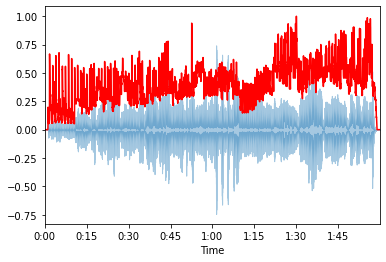

In [67]:
# Feature: Spectral Rolloff - It is a measure of the shape of the signal. It represents the 
#           frequency below which a specified percentage of the total spectral energy, e.g.
#           85% lies. 
# librosa.feature.spectral_rollof - computes the rolloff frequency for each frame in a signal.

# Feature extraction sample
%matplotlib inline
import matplotlib.pyplot as plt
import librosa
import librosa.display

# Load the example clip
x, sr = librosa.load(librosa.ex('nutcracker'))

spectral_rolloff = librosa.feature.spectral_rolloff(x+0.01, sr=sr)[0]
librosa.display.waveplot(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_rolloff), color='r')

(20, 5163)
[-2.72362061e+02  1.26635155e+02 -3.27574387e+01  1.03137207e+01
 -1.89520817e+01 -9.65540218e+00 -1.56173029e+01 -1.01638575e+01
 -1.73767757e+01 -9.52495193e+00 -1.03115969e+01 -3.99467063e+00
 -9.19406986e+00 -5.49913979e+00 -4.73061800e+00 -3.19303894e+00
 -4.54213095e+00 -2.76066232e+00 -5.25084639e+00 -2.62145162e-01]
[9012.667   1069.3984   966.3314   534.01514  475.18622  322.3089
  301.05737  198.56154  192.72133  137.688    158.63928  160.88173
  178.33403  137.49702  149.39928  122.60193  139.40619  120.2443
  111.996    135.54568]
[ 1.1821646e-08  0.0000000e+00  2.3643292e-08  0.0000000e+00
  5.9108229e-09  1.1821646e-08  0.0000000e+00  7.3885285e-09
  0.0000000e+00  5.9108229e-09  1.7732468e-08  8.8662340e-09
  8.8662340e-09  1.1821646e-08 -2.3643292e-08  0.0000000e+00
  2.9554115e-09 -1.1821646e-08 -1.7732468e-08  0.0000000e+00]
[1.0000001 1.0000002 0.9999999 0.9999998 1.        1.0000002 1.
 1.        0.9999999 0.9999999 1.        1.        1.0000001 1.
 1.000

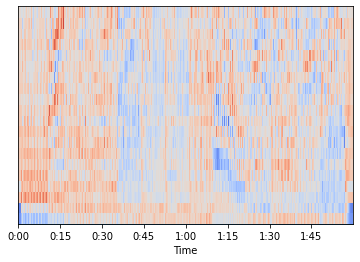

In [75]:
# Feature: Mel-Frequency Cepstral Coefficients (MFCCs) - of a signal are a
#           small set of features (usually about 10-20), which concisely describe
#           the overall shape of a spectral envelope. It models the characteristics
#           of the human voice.
# librosa.feature.mfcc computes the MFCCs across an audio signal

# Feature extraction sample
%matplotlib inline
import matplotlib.pyplot as plt
import librosa
import librosa.display
import sklearn

# Load the example clip
x, fs = librosa.load(librosa.ex('nutcracker'))
librosa.display.waveplot(x, sr=sr)

mfccs = librosa.feature.mfcc(x, sr=fs)
print(mfccs.shape)

# Displaying the MFCCs
librosa.display.specshow(mfccs, sr=sr, x_axis='time')
print(mfccs.mean(axis=1))
print(mfccs.var(axis=1))

# Here mfcc computed 20 MFCCs over 5163 frames

# We can also perform feature scaling such that each coefficient dimension
#   has zero mean and unit variance
mfccs = sklearn.preprocessing.scale(mfccs, axis=1)
print(mfccs.mean(axis=1))
print(mfccs.var(axis=1))

librosa.display.specshow(mfccs, sr=sr, x_axis='time')


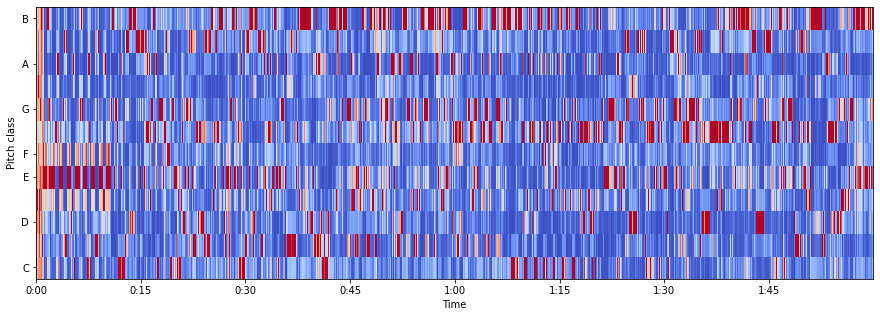

In [77]:
# Feature: Chroma Frequencies - Chroma features are an interesting and powerful
#           representation for music audio in which the entire spectrum is projected
#           onto 12 bins representing the 12 distinct semitones (or chroma) of the
#           musical octave.
# librosa.feature.chroma_stft is used for computation

# Feature extraction sample
%matplotlib inline
import matplotlib.pyplot as plt
import librosa
import librosa.display
import sklearn

# Load the example clip
x, sr = librosa.load(librosa.ex('nutcracker'))

hop_length = 512
chromagram = librosa.feature.chroma_stft(x, sr=sr, hop_length=hop_length)
plt.figure(figsize=(15, 5))
librosa.display.specshow(chromagram, x_axis='time', y_axis='chroma', hop_length=hop_length, cmap='coolwarm')

In [ ]:
# Case Study: Classify songs into different genres
# Objective: Model a classifier to classify songs into different genres.
# Dataset: GITZAN dataset
# Preprocessing the data: Before training the classification model, we have to transform
#                           raw data from audio samples into more meaningful representations.
#                           The audio clips need to be converted from .au format to .wav format
#                           to make it compatible with python's wave module for reading audio
#                           files. If needed to convert, use sox input.au output.wav. 
#                           link: https://www.stefaanlippens.net/audio_conversion_cheat_sheet/
# Classification:
#   Feature Extraction: We need to extract meaningful features from audio files. To classify 
#                       audio clips, we will choose five features, i.e. Mel-Frequency Cepstral
#                       Coefficients, Spectral Centroid, Zero Crossing Rate, Chroma Frequencies,
#                       Spectral Roll-off. All of the features are then appended into a .csv file
#                       so that classification algorithms can be used.
#   Classification: Once the features have been extracted, we can use existing classification
#                   algorithms to classify the songs into different genres. You can either use the
#                   spectogram images directly for classification or you can extract the features
#                   and use the classification models on them. Usig a CNN model (on the spectogram
#                   images) gives a better accuracy.